### Starting the Jupyter Notebook in GPU because of time constraints

In [2]:
import tensorflow as tf
from tensorflow.python.client import device_lib
device_lib.list_local_devices()
gpus = tf.config.list_physical_devices('GPU')
print(gpus)
for gpu in gpus:
    tf.config.experimental.set_memory_growth(gpu, True)

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


# Building Music Recommendation System using Spotify Dataset

In this kernel, I have created Music Recommendation System using Spotify Dataset. To do this, I presented some of the visualization processes to understand data and done some EDA(Exploratory Data Analysis) so we can select features that are relevant to create a Recommendation System.

In [3]:
import os
import numpy as np
import pandas as pd

import seaborn as sns
import plotly.express as px 
import matplotlib.pyplot as plt
%matplotlib inline

from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
from sklearn.metrics import euclidean_distances
from scipy.spatial.distance import cdist

import warnings
warnings.filterwarnings("ignore")

# Read Data

In [4]:
data = pd.read_csv("data.csv")
genre_data = pd.read_csv('data_by_genres.csv')
year_data = pd.read_csv('data_by_year.csv')

In [5]:
data

,valence,year,acousticness,artists,danceability,duration_ms,energy,explicit,id,instrumentalness,key,liveness,loudness,mode,name,popularity,release_date,speechiness,tempo
0,0.0594,1921,0.9820,"['Sergei Rachmaninoff', 'James Levine', 'Berli...",0.279,831667,0.211,0,4BJqT0PrAfrxzMOxytFOIz,0.878000,10,0.6650,-20.096,1,"Piano Concerto No. 3 in D Minor, Op. 30: III. ...",4,1921,0.0366,80.954
1,0.9630,1921,0.7320,['Dennis Day'],0.819,180533,0.341,0,7xPhfUan2yNtyFG0cUWkt8,0.000000,7,0.1600,-12.441,1,Clancy Lowered the Boom,5,1921,0.4150,60.936
2,0.0394,1921,0.9610,['KHP Kridhamardawa Karaton Ngayogyakarta Hadi...,0.328,500062,0.166,0,1o6I8BglA6ylDMrIELygv1,0.913000,3,0.1010,-14.850,1,Gati Bali,5,1921,0.0339,110.339
3,0.1650,1921,0.9670,['Frank Parker'],0.275,210000,0.309,0,3ftBPsC5vPBKxYSee08FDH,0.000028,5,0.3810,-9.316,1,Danny Boy,3,1921,0.0354,100.109
4,0.2530,1921,0.9570,['Phil Regan'],0.418,166693,0.193,0,4d6HGyGT8e121BsdKmw9v6,0.000002,3,0.2290,-10.096,1,When Irish Eyes Are Smiling,2,1921,0.0380,101.665
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
170669,0.1830,2022,0.0270,['NewJeans'],0.814,185507,0.641,0,3r8RuvgbX9s7ammBn07D3W,0.000000,6,0.0993,-5.957,0,Ditto,91,2022,0.1110,133.854
170670,0.7830,2022,0.2680,['NewJeans'],0.593,179027,0.935,0,0a4MMyCrzT0En247IhqZbD,0.000000,4,0.2860,-3.430,0,Hype Boy,88,2022,0.2250,99.976
170671,0.3560,2021,0.0361,['NAYEON'],0.795,168107,0.859,0,3lOMJTQTd6J34faYwASc33,0.000000,2,0.0321,-2.994,1,POP!,79,2021,0.0542,96.986
170672,0.5880,1961,0.5500,['The Turtles'],0.584,176293,0.367,0,1JO1xLtVc8mWhIoE3YaCL0,0.000014,6,0.0818,-9.638,0,Happy Together,77,1961,0.0328,120.175


In [6]:
genre_data

,mode,genres,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key
0,1,21st century classical,0.979333,0.162883,1.602977e+05,0.071317,0.606834,0.361600,-31.514333,0.040567,75.336500,0.103783,27.833333,6
1,1,432hz,0.494780,0.299333,1.048887e+06,0.450678,0.477762,0.131000,-16.854000,0.076817,120.285667,0.221750,52.500000,5
2,1,8-bit,0.762000,0.712000,1.151770e+05,0.818000,0.876000,0.126000,-9.180000,0.047000,133.444000,0.975000,48.000000,7
3,1,[],0.651417,0.529093,2.328809e+05,0.419146,0.205309,0.218696,-12.288965,0.107872,112.857352,0.513604,20.859882,7
4,1,a cappella,0.676557,0.538961,1.906285e+05,0.316434,0.003003,0.172254,-12.479387,0.082851,112.110362,0.448249,45.820071,7
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2968,1,zolo,0.222625,0.547082,2.580991e+05,0.610240,0.143872,0.204206,-11.295878,0.061088,125.494919,0.596155,33.778943,9
2969,0,zouglou,0.161000,0.863000,2.063200e+05,0.909000,0.000000,0.108000,-5.985000,0.081300,119.038000,0.845000,58.000000,7
2970,1,zouk,0.263261,0.748889,3.060728e+05,0.622444,0.257227,0.089678,-10.289222,0.038778,101.965222,0.824111,46.666667,5
2971,0,zurich indie,0.993000,0.705667,1.984173e+05,0.172667,0.468633,0.179667,-11.453333,0.348667,91.278000,0.739000,0.000000,7


In [7]:
year_data 

,mode,year,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key
0,1,1921,0.886896,0.418597,260537.166667,0.231815,0.344878,0.205710,-17.048667,0.073662,101.531493,0.379327,0.653333,2
1,1,1922,0.938592,0.482042,165469.746479,0.237815,0.434195,0.240720,-19.275282,0.116655,100.884521,0.535549,0.140845,10
2,1,1923,0.957247,0.577341,177942.362162,0.262406,0.371733,0.227462,-14.129211,0.093949,114.010730,0.625492,5.389189,0
3,1,1924,0.940200,0.549894,191046.707627,0.344347,0.581701,0.235219,-14.231343,0.092089,120.689572,0.663725,0.661017,10
4,1,1925,0.962607,0.573863,184986.924460,0.278594,0.418297,0.237668,-14.146414,0.111918,115.521921,0.621929,2.604317,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,1,2016,0.284171,0.600202,221396.510295,0.592855,0.093984,0.181170,-8.061056,0.104313,118.652630,0.431532,59.647190,0
96,1,2017,0.286099,0.612217,211115.696787,0.590421,0.097091,0.191713,-8.312630,0.110536,117.202740,0.416476,63.263554,1
97,1,2018,0.267633,0.663500,206001.007133,0.602435,0.054217,0.176326,-7.168785,0.127176,121.922308,0.447921,63.296243,1
98,1,2019,0.278299,0.644814,201024.788096,0.593224,0.077640,0.172616,-7.722192,0.121043,120.235644,0.458818,65.256542,1


In [8]:
# print(data.info())
# print(genre_data.info())
# print(year_data.info())

We are going to check for all the analysis with the target as **'popularity'**. Before going to do that let's check for the Feature Correlation by considering a few features and for that, I'm going to use the **yellowbrick** package. You can learn more about it from the [documentation](https://www.scikit-yb.org/en/latest/index.html).

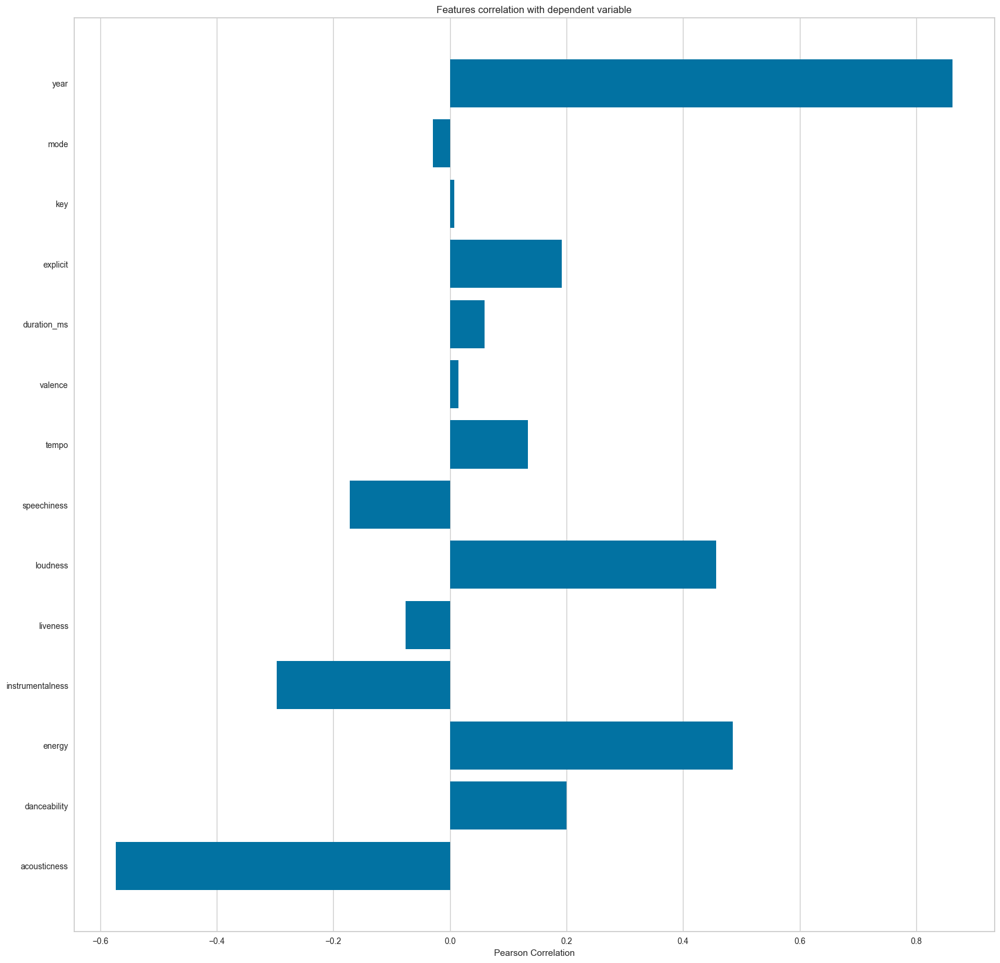

<Axes: title={'center': 'Features correlation with dependent variable'}, xlabel='Pearson Correlation'>

In [9]:
from yellowbrick.target import FeatureCorrelation

feature_names = ['acousticness', 'danceability', 'energy', 'instrumentalness',
       'liveness', 'loudness', 'speechiness', 'tempo', 'valence','duration_ms','explicit','key','mode','year']

X, y = data[feature_names], data['popularity']

# Create a list of the feature names
features = np.array(feature_names)

# Instantiate the visualizer
visualizer = FeatureCorrelation(labels=features)

plt.rcParams['figure.figsize']=(20,20)
visualizer.fit(X, y)     # Fit the data to the visualizer
visualizer.show()

The Pearson correlation coefficient (r) is the most common way of measuring a linear correlation. It is a number between –1 and 1 that measures the strength and direction of the relationship between two variables.

# Data Understanding by Visualization and EDA

# **Music Over Time**

Using the data grouped by year, we can understand how the overall sound of music has changed from 1921 to 2020.

<Axes: xlabel='decade', ylabel='count'>

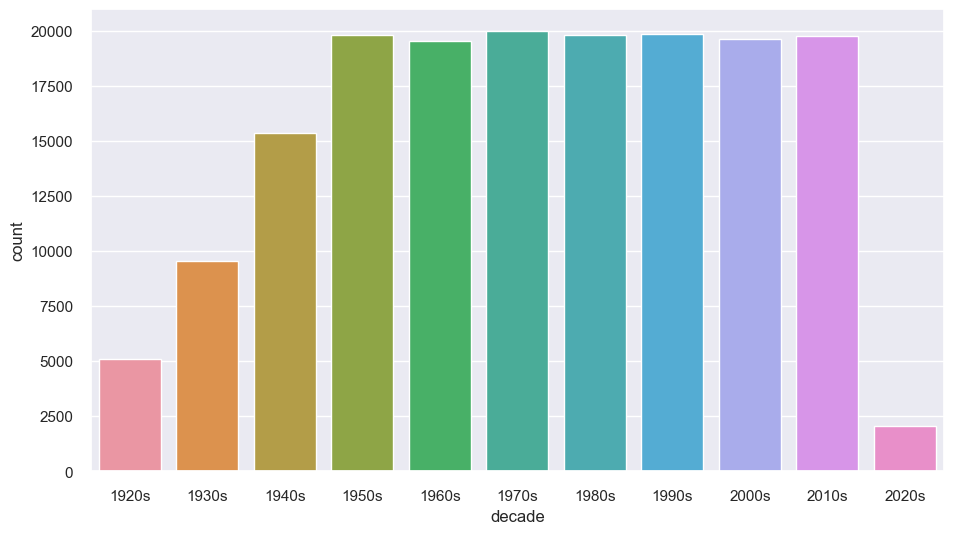

In [10]:
def get_decade(year):
    period_start = int(year/10) * 10
    decade = '{}s'.format(period_start)
    return decade

data['decade'] = data['year'].apply(get_decade)

sns.set(rc={'figure.figsize':(11 ,6)})
sns.countplot(x= data['decade'])

In [11]:
sound_features = ['acousticness', 'danceability', 'energy', 'instrumentalness', 'liveness', 'valence']
fig = px.line(year_data, x='year', y=sound_features)
fig.show()

# **Characteristics of Different Genres**

This dataset contains the audio features for different songs along with the audio features for different genres. We can use this information to compare different genres and understand their unique differences in sound.

In [12]:
top10_genres = genre_data.nlargest(10, 'popularity')

fig = px.bar(top10_genres, x='genres', y=['valence', 'energy', 'acousticness', 'speechiness'], barmode='group')
fig.show()

# **Clustering Genres with Agglomerative Clustering**

Here, the simple Agglomerative clustering algorithm is used to divide the genres in this dataset into twenty clusters based in the numerical audio features of each genres.

In [13]:
from sklearn.cluster import AgglomerativeClustering
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
import plotly.express as px 

agg_pipeline = Pipeline(
    [('scaler', StandardScaler()), ('agglomerativeclustering', AgglomerativeClustering(n_clusters=20))]
)
X = genre_data.select_dtypes(np.number)
agg_pipeline.fit(X)
genre_data['cluster']= agg_pipeline.fit_predict(X)

In [14]:
from sklearn.manifold import TSNE

tsne_pipeline = Pipeline([('scaler', StandardScaler()), ('tsne', TSNE(n_components=2, verbose=1))])
genre_embedding = tsne_pipeline.fit_transform(X)
projection = pd.DataFrame(columns=['x', 'y'], data=genre_embedding)
projection['genres'] = genre_data['genres']
projection['cluster'] = genre_data['cluster']

fig = px.scatter(
    projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'genres'])
fig.show()

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 2973 samples in 0.017s...
[t-SNE] Computed neighbors for 2973 samples in 0.224s...
[t-SNE] Computed conditional probabilities for sample 1000 / 2973
[t-SNE] Computed conditional probabilities for sample 2000 / 2973
[t-SNE] Computed conditional probabilities for sample 2973 / 2973
[t-SNE] Mean sigma: 0.777516
[t-SNE] KL divergence after 250 iterations with early exaggeration: 76.106216
[t-SNE] KL divergence after 1000 iterations: 1.393216


# **Clustering Genres with K-Means**

Here, the simple K-means clustering algorithm is used to divide the genres in this dataset into ten clusters based on the numerical audio features of each genres.

In [15]:
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline

cluster_pipeline = Pipeline([('scaler', StandardScaler()), ('kmeans', KMeans(n_clusters=10))])
X = genre_data.select_dtypes(np.number)
cluster_pipeline.fit(X)
genre_data['cluster'] = cluster_pipeline.predict(X)

In [16]:
# Visualizing the Clusters with t-SNE

from sklearn.manifold import TSNE

tsne_pipeline = Pipeline([('scaler', StandardScaler()), ('tsne', TSNE(n_components=2, verbose=1))])
genre_embedding = tsne_pipeline.fit_transform(X)
projection = pd.DataFrame(columns=['x', 'y'], data=genre_embedding)
projection['genres'] = genre_data['genres']
projection['cluster'] = genre_data['cluster']

fig = px.scatter(
    projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'genres'])
fig.show()

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 2973 samples in 0.005s...
[t-SNE] Computed neighbors for 2973 samples in 0.249s...
[t-SNE] Computed conditional probabilities for sample 1000 / 2973
[t-SNE] Computed conditional probabilities for sample 2000 / 2973
[t-SNE] Computed conditional probabilities for sample 2973 / 2973
[t-SNE] Mean sigma: 0.836224
[t-SNE] KL divergence after 250 iterations with early exaggeration: 71.645912
[t-SNE] KL divergence after 1000 iterations: 1.094766


# **Clustering Songs with K-Means**

In [17]:
song_cluster_pipeline = Pipeline([('scaler', StandardScaler()), 
                                  ('kmeans', KMeans(n_clusters=20, verbose=False))], verbose=False)

X = data.select_dtypes(np.number)
number_cols = list(X.columns)
song_cluster_pipeline.fit(X)
song_cluster_labels = song_cluster_pipeline.predict(X)
data['cluster_label'] = song_cluster_labels

In [18]:
# Visualizing the Clusters with PCA

from sklearn.decomposition import PCA

pca_pipeline = Pipeline([('scaler', StandardScaler()), ('PCA', PCA(n_components=2))])
song_embedding = pca_pipeline.fit_transform(X)
projection = pd.DataFrame(columns=['x', 'y'], data=song_embedding)
projection['title'] = data['name']
projection['cluster'] = data['cluster_label']

fig = px.scatter(
    projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'title'])
fig.show()

# Clustering Genres with DBSCAN

In [19]:
# from sklearn.cluster import DBSCAN

In [20]:
# from sklearn.neighbors import NearestNeighbors # importing the library
# neighb = NearestNeighbors(n_neighbors=2) # creating an object of the NearestNeighbors class
# nbrs=neighb.fit(X) # fitting the data to the object
# distances,indices=nbrs.kneighbors(X) # finding the nearest neighbours

In [21]:
# # Sort and plot the distances results
# distances = np.sort(distances, axis = 0) # sorting the distances
# distances = distances[:, 1] # taking the second column of the sorted distances
# plt.rcParams['figure.figsize'] = (5,3) # setting the figure size
# plt.plot(distances) # plotting the distances
# plt.show() # showing the plot

In [22]:
# dbscan_cluster_pipeline = Pipeline([('scaler', StandardScaler()), ('dbscan', DBSCAN(eps=0.57, min_samples=3))])
# X = genre_data.select_dtypes(np.number)
# genre_data['cluster'] = dbscan_cluster_pipeline.fit_predict(X)

In [23]:
# tsne_pipeline = Pipeline([('scaler', StandardScaler()), ('tsne', TSNE(n_components=2, verbose=1))])
# genre_embedding = tsne_pipeline.fit_transform(X)
# projection = pd.DataFrame(columns=['x', 'y'], data=genre_embedding)
# projection['genres'] = genre_data['genres']
# projection['cluster'] = genre_data['cluster']

# fig = px.scatter(
#     projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'genres'])
# fig.show()

# Clustering Genres with Hierarchical Clustering

In [24]:
# import numpy as np
# from scipy.cluster.hierarchy import linkage, dendrogram
# import matplotlib.pyplot as plt

# X = genre_data.select_dtypes(np.number)

# distances = linkage(X, method='ward', metric='euclidean')

# dendrogram(distances)
# plt.show()

# **Build Recommender System**

* Based on the analysis and visualizations, it’s clear that similar genres tend to have data points that are located close to each other while similar types of songs are also clustered together.
* This observation makes perfect sense. Similar genres will sound similar and will come from similar time periods while the same can be said for songs within those genres. We can use this idea to build a recommendation system by taking the data points of the songs a user has listened to and recommending songs corresponding to nearby data points.
* [Spotipy](https://spotipy.readthedocs.io/en/2.16.1/) is a Python client for the Spotify Web API that makes it easy for developers to fetch data and query Spotify’s catalog for songs.
* After installing Spotipy, you will need to create an app on the [Spotify Developer’s page](https://developer.spotify.com/) and save your Client ID and secret key.

In [25]:
import spotipy
from spotipy.oauth2 import SpotifyClientCredentials
from collections import defaultdict
from sklearn.metrics import euclidean_distances
from scipy.spatial.distance import cdist
import difflib
import csv

sp = spotipy.Spotify(auth_manager=SpotifyClientCredentials(client_id="6adf3f32bf17412c8c563a8b7c4935e0",
                                                           client_secret="5f0d2b7cd1244ae5b217db32bf9ffed0"))

def find_song(name, year):
    song_data = defaultdict()

    results = sp.search(q= 'track: {} year: {}'.format(name,year), limit=1)
    
    if results['tracks']['items'] == []:
        return None

    results = results['tracks']['items'][0]
    track_id = results['id']
    audio_features = sp.audio_features(track_id)[0]

    song_data['name'] = [name]
    song_data['year'] = [year]
    song_data['explicit'] = [int(results['explicit'])]
    song_data['duration_ms'] = [results['duration_ms']]
    song_data['popularity'] = [results['popularity']]

    for key, value in audio_features.items():
        song_data[key] = value

    return pd.DataFrame(song_data)

number_cols = ['valence', 'year', 'acousticness', 'danceability', 'duration_ms', 'energy', 'explicit',
 'instrumentalness', 'key', 'liveness', 'loudness', 'mode', 'popularity', 'speechiness', 'tempo']


def get_song_data(song, spotify_data):
    
    try:
        song_data = spotify_data[(spotify_data['name'] == song['name']) 
                                & (spotify_data['year'] == song['year'])].iloc[0]
        return song_data
   # valence	year	acousticness	artists	danceability	duration_ms	energy	explicit	id	instrumentalness	key	liveness	loudness	mode	name	popularity	release_date	speechiness	tempo

    except IndexError:
        try:
            x = sp.search("q: {} year: {} artists: {}".format(song['name'], song['year'], song['artists']), limit=1)
            d = sp.audio_features(x['tracks']['items'][0]['id'])[0]
            a = [(x['tracks']['items'][0]['artists'][0]['name'])]
            l = [d['valence'], song['year'], d['acousticness'], a, d['danceability'], d['duration_ms'], d['energy'], int(x['tracks']['items'][0]['explicit']), d['id'], d['instrumentalness'], d['key'], d['liveness'], d['loudness'], d['mode'], x['tracks']['items'][0]['name'], int(x['tracks']['items'][0]['popularity']), song['year'], d['speechiness'], d['tempo']]
            with open("./data.csv", "a", newline='') as f:
                w = csv.writer(f)
                flag = False
                k = [str(i) for i in l]
                with open('./data.csv', 'r') as f_read:
                    r = csv.reader(f_read)
                    for row in r:
                        if row == k:
                            flag = True
                            break   
                    if not flag:
                        w.writerow(l)
                        f.close()     
        except:
            pass   
        
        return find_song(song['name'], song['year'])
        

def get_mean_vector(song_list, spotify_data):
    
    song_vectors = []
    
    for song in song_list:
        song_data = get_song_data(song, spotify_data)
        if song_data is None:
            print('Warning: {} does not exist in Spotify or in database'.format(song['name']))
            continue
        song_vector = song_data[number_cols].values
        song_vectors.append(song_vector)  
    
    song_matrix = np.array(list(song_vectors))
    return np.mean(song_matrix, axis=0)


def flatten_dict_list(dict_list):
    
    flattened_dict = defaultdict()
    for key in dict_list[0].keys():
        flattened_dict[key] = []
    
    for dictionary in dict_list:
        for key, value in dictionary.items():
            if value not in dictionary.items():
                flattened_dict[key].append(value)
            
    return flattened_dict


def recommend_songs( song_list, spotify_data, n_songs=11):
    
    metadata_cols = ['name', 'year', 'artists']
    song_dict = flatten_dict_list(song_list)
    
    song_center = get_mean_vector(song_list, spotify_data)
    scaler = song_cluster_pipeline.steps[0][1]
    scaled_data = scaler.transform(spotify_data[number_cols])
    scaled_song_center = scaler.transform(song_center.reshape(1, -1))
    distances = cdist(scaled_song_center, scaled_data, 'cosine')
    index = list(np.argsort(distances)[:, :n_songs][0])
    
    rec_songs = spotify_data.iloc[index]
    rec_songs = rec_songs[~rec_songs['name'].isin(song_dict['name'])]
    return rec_songs[metadata_cols].to_dict(orient='records')

def recommend(name, year, artists):
    return recommend_songs([{'name': name, 'year':year, 'artists': artists}], data)

In [26]:
recommend_songs([{'name': 'AYA', 'year': 2020, 'artists': 'MAMAMOO'}], data)

[{'name': '廻廻奇譚', 'year': 2020, 'artists': "['Eve']"},
 {'name': 'Egotistic', 'year': 2018, 'artists': "['MAMAMOO']"},
 {'name': 'S.L.U.T.', 'year': 2018, 'artists': "['Bea Miller']"},
 {'name': 'We Went', 'year': 2016, 'artists': "['Randy Houser']"},
 {'name': 'I Need U', 'year': 2016, 'artists': "['BTS']"},
 {'name': 'Not Shy', 'year': 2020, 'artists': "['ITZY']"},
 {'name': 'My Sweet Summer', 'year': 2014, 'artists': "['Dirty Heads']"},
 {'name': 'Misery', 'year': 2010, 'artists': "['Maroon 5']"},
 {'name': 'Humanos a Marte', 'year': 2014, 'artists': "['Chayanne']"},
 {'name': 'The Adventures of Rain Dance Maggie',
  'year': 2011,
  'artists': "['Red Hot Chili Peppers']"}]

In [27]:
recommend('POP', 2022, 'Nayeon')

[{'name': 'POP!', 'year': 2021, 'artists': "['NAYEON']"},
 {'name': 'Me Rehúso', 'year': 2017, 'artists': "['Danny Ocean']"},
 {'name': 'Me Rehúso', 'year': 2019, 'artists': "['Danny Ocean']"},
 {'name': 'Looking at Me', 'year': 2019, 'artists': "['Sabrina Carpenter']"},
 {'name': 'Moonshine', 'year': 2012, 'artists': "['Bruno Mars']"},
 {'name': 'Best Day Of My Life',
  'year': 2014,
  'artists': "['American Authors']"},
 {'name': 'Perfect', 'year': 2015, 'artists': "['One Direction']"},
 {'name': 'Don’t Call Me Angel (Charlie’s Angels) (with Miley Cyrus & Lana Del Rey)',
  'year': 2019,
  'artists': "['Ariana Grande', 'Miley Cyrus', 'Lana Del Rey']"},
 {'name': 'Sledgehammer', 'year': 2015, 'artists': "['Fifth Harmony']"},
 {'name': 'Aw Naw', 'year': 2013, 'artists': "['Chris Young']"}]

In [28]:
recommend('Fake Love', 2018, 'BTS')

[{'name': 'FAKE LOVE', 'year': 2018, 'artists': "['BTS']"},
 {'name': 'FAKE LOVE', 'year': 2018, 'artists': "['BTS']"},
 {'name': "Please Don't Go", 'year': 2015, 'artists': "['Joel Adams']"},
 {'name': 'Hymn for the Weekend', 'year': 2015, 'artists': "['Coldplay']"},
 {'name': 'Sorry', 'year': 2015, 'artists': "['Justin Bieber']"},
 {'name': 'THE DAY', 'year': 2017, 'artists': "['PornoGraffitti']"},
 {'name': 'Lose It', 'year': 2019, 'artists': "['Kane Brown']"},
 {'name': 'WILD', 'year': 2015, 'artists': "['Troye Sivan']"},
 {'name': 'Through Glass', 'year': 2006, 'artists': "['Stone Sour']"},
 {'name': 'Scared of the Dark (feat. XXXTENTACION)',
  'year': 2018,
  'artists': "['Lil Wayne', 'Ty Dolla $ign', 'XXXTENTACION']"}]

In [29]:
recommend('hype boy', 2022, 'NEWJEANS')

[{'name': 'Hype Boy', 'year': 2022, 'artists': "['NewJeans']"},
 {'name': 'Say My Name',
  'year': 2019,
  'artists': "['Alex Brightman', 'Sophia Anne Caruso', 'Kerry Butler', 'Rob McClure']"},
 {'name': 'AYA', 'year': 2020, 'artists': "['MAMAMOO']"},
 {'name': 'Life Is Fun',
  'year': 2018,
  'artists': "['Boyinaband', 'TheOdd1sOut']"},
 {'name': 'Chica Ideal',
  'year': 2020,
  'artists': "['Sebastian Yatra', 'Guaynaa']"},
 {'name': '廻廻奇譚', 'year': 2020, 'artists': "['Eve']"},
 {'name': 'Levitating', 'year': 2020, 'artists': "['Dua Lipa']"},
 {'name': 'Bandoleros',
  'year': 2006,
  'artists': "['Don Omar', 'Tego Calderon']"},
 {'name': 'TiK ToK', 'year': 2010, 'artists': "['Kesha']"},
 {'name': 'Not Shy', 'year': 2020, 'artists': "['ITZY']"},
 {'name': 'Egotistic', 'year': 2018, 'artists': "['MAMAMOO']"}]

In [30]:
recommend('FEARLESS', 2022, 'LE SSERAFIM')

[{'name': 'Gorgeous', 'year': 2017, 'artists': "['Taylor Swift']"},
 {'name': 'What A Man Gotta Do',
  'year': 2020,
  'artists': "['Jonas Brothers']"},
 {'name': 'Freedom', 'year': 2020, 'artists': "['Kygo', 'Zak Abel']"},
 {'name': 'Most Girls', 'year': 2017, 'artists': "['Hailee Steinfeld']"},
 {'name': 'Stacy', 'year': 2020, 'artists': "['Quinn XCII']"},
 {'name': 'Pon de Replay', 'year': 2005, 'artists': "['Rihanna']"},
 {'name': 'Glitter', 'year': 2019, 'artists': "['BENEE']"},
 {'name': 'Cooler Than Me', 'year': 2019, 'artists': "['Lucky Luke']"},
 {'name': 'Strip That Down (feat. Quavo)',
  'year': 2019,
  'artists': "['Liam Payne', 'Quavo']"},
 {'name': 'Work from Home (feat. Ty Dolla $ign)',
  'year': 2016,
  'artists': "['Fifth Harmony', 'Ty Dolla $ign']"}]

In [31]:
recommend('Butter', 2021, 'BTS')

[{'name': 'Butterfly', 'year': 2015, 'artists': "['BTS']"},
 {'name': 'Butterfly', 'year': 2016, 'artists': "['BTS']"},
 {'name': 'Dog Days Are Over',
  'year': 2009,
  'artists': "['Florence + The Machine']"},
 {'name': 'MONSTERS', 'year': 2018, 'artists': "['Shinedown']"},
 {'name': 'GIRL', 'year': 2019, 'artists': "['Maren Morris']"},
 {'name': 'Zombie (Live from the NIVA Save Our Stages Festival)',
  'year': 2020,
  'artists': "['Miley Cyrus']"},
 {'name': 'Everywhere But On', 'year': 2019, 'artists': "['Matt Stell']"},
 {'name': 'True Friends', 'year': 2015, 'artists': "['Bring Me The Horizon']"},
 {'name': 'Wildfire', 'year': 2019, 'artists': "['Nate Smith']"},
 {'name': 'Need U Bad', 'year': 2008, 'artists': "['Jazmine Sullivan']"}]

In [32]:
recommend('POP', 2021, 'Nayeon')

[{'name': 'I Know', 'year': 2020, 'artists': "['Polo G']"},
 {'name': 'POPSTAR (feat. Drake)',
  'year': 2020,
  'artists': "['DJ Khaled', 'Drake']"},
 {'name': 'Handsome',
  'year': 2019,
  'artists': "['Chance the Rapper', 'Megan Thee Stallion']"},
 {'name': 'Die Young', 'year': 2018, 'artists': "['Roddy Ricch']"},
 {'name': 'Patek Water (feat. Offset)',
  'year': 2017,
  'artists': "['Future', 'Young Thug', 'Offset']"},
 {'name': 'Only The Team (with Lil Mosey & Lil Tjay)',
  'year': 2020,
  'artists': "['Rvssian', 'Lil Mosey', 'Lil Tjay']"},
 {'name': 'No Stylist (feat. Drake)',
  'year': 2018,
  'artists': "['French Montana', 'Drake']"},
 {'name': 'Truth Hurts', 'year': 2019, 'artists': "['Lizzo']"},
 {'name': 'Gifted (feat. Roddy Ricch)',
  'year': 2020,
  'artists': "['Cordae', 'Roddy Ricch']"},
 {'name': 'Money Longer', 'year': 2016, 'artists': "['Lil Uzi Vert']"},
 {'name': 'Gassed Up', 'year': 2016, 'artists': "['Nebu Kiniza']"}]

In [33]:
recommend('Like Crazy', 2023, 'Jimin')

[{'name': 'Maniac', 'year': 2020, 'artists': "['Conan Gray']"},
 {'name': 'Christmas Tree Farm', 'year': 2019, 'artists': "['Taylor Swift']"},
 {'name': 'Best Of Me', 'year': 2018, 'artists': "['BTS']"},
 {'name': 'Heroes (we could be)',
  'year': 2015,
  'artists': "['Alesso', 'Tove Lo']"},
 {'name': 'Let Me Love You (Until You Learn To Love Yourself)',
  'year': 2012,
  'artists': "['Ne-Yo']"},
 {'name': 'El Farsante', 'year': 2017, 'artists': "['Ozuna']"},
 {'name': 'Insomnia', 'year': 2019, 'artists': "['Daya']"},
 {'name': 'Team', 'year': 2013, 'artists': "['Lorde']"},
 {'name': 'Best Of Me', 'year': 2017, 'artists': "['BTS']"},
 {'name': 'Team', 'year': 2013, 'artists': "['Lorde']"}]

In [34]:
recommend('stay alive', 2022, 'jung kook')

[{'name': 'Team Rocket', 'year': 2016, 'artists': "['Lil Uzi Vert']"},
 {'name': 'hellboy', 'year': 2020, 'artists': "['Lil Peep']"},
 {'name': 'Never Needed No Help', 'year': 2018, 'artists': "['Lil Baby']"},
 {'name': 'High Right Now (feat. Wiz Khalifa) - Remix',
  'year': 2020,
  'artists': "['Tyla Yaweh', 'Wiz Khalifa']"},
 {'name': 'All These Niggas (feat. Lil Durk)',
  'year': 2020,
  'artists': "['King Von', 'Lil Durk']"},
 {'name': 'Hype', 'year': 2016, 'artists': "['Drake']"},
 {'name': 'Wake Up in the Sky',
  'year': 2018,
  'artists': "['Gucci Mane', 'Bruno Mars', 'Kodak Black']"},
 {'name': 'Falling Down - Bonus Track',
  'year': 2018,
  'artists': "['Lil Peep', 'XXXTENTACION']"},
 {'name': "Can't Love", 'year': 2018, 'artists': "['Trippie Redd']"},
 {'name': 'Wake Up in the Sky',
  'year': 2018,
  'artists': "['Gucci Mane', 'Bruno Mars', 'Kodak Black']"},
 {'name': '10,000 Hours', 'year': 2016, 'artists': "['Ella Mai']"}]

In [35]:
recommend('FLOWER', 2023, 'JISOO')

[{'name': 'Señorita',
  'year': 2019,
  'artists': "['Shawn Mendes', 'Camila Cabello']"},
 {'name': 'Señorita',
  'year': 2019,
  'artists': "['Shawn Mendes', 'Camila Cabello']"},
 {'name': 'Car Radio', 'year': 2013, 'artists': "['Twenty One Pilots']"},
 {'name': "I Don't Know You", 'year': 2017, 'artists': "['The Marías']"},
 {'name': '4EVER', 'year': 2018, 'artists': "['Clairo']"},
 {'name': 'still feel.', 'year': 2019, 'artists': "['half•alive']"},
 {'name': 'Therefore I Am', 'year': 2020, 'artists': "['Billie Eilish']"},
 {'name': 'Faded', 'year': 2014, 'artists': "['ZHU']"},
 {'name': 'Kingston', 'year': 2019, 'artists': "['Faye Webster']"},
 {'name': 'South of the Border (feat. Camila Cabello & Cardi B)',
  'year': 2019,
  'artists': "['Ed Sheeran', 'Camila Cabello', 'Cardi B']"}]

In [36]:
recommend('SOLO', 2018, 'JENNIE')

[{'name': 'Outta Time (feat. Drake)',
  'year': 2020,
  'artists': "['Bryson Tiller', 'Drake']"},
 {'name': 'Outta Time (feat. Drake)',
  'year': 2020,
  'artists': "['Bryson Tiller', 'Drake']"},
 {'name': 'SOS (feat. Aloe Blacc)',
  'year': 2019,
  'artists': "['Avicii', 'Aloe Blacc']"},
 {'name': 'It Girl', 'year': 2011, 'artists': "['Jason Derulo']"},
 {'name': 'OK Not To Be OK',
  'year': 2020,
  'artists': "['Marshmello', 'Demi Lovato']"},
 {'name': 'Best In Me', 'year': 2001, 'artists': "['Blue']"},
 {'name': 'What Lovers Do (feat. SZA)',
  'year': 2018,
  'artists': "['Maroon 5', 'SZA']"},
 {'name': 'Nanã', 'year': 2017, 'artists': "['Polo & Pan']"},
 {'name': 'I don’t even speak spanish lol - feat. Rio Santana, Judah, Andrez Babii',
  'year': 2018,
  'artists': "['XXXTENTACION', 'Rio Santana', 'Judah', 'Andrez Babii']"},
 {'name': 'Thick And Thin', 'year': 2018, 'artists': "['LANY']"}]

In [37]:
recommend('GONE', 2021, 'ROSE')

[{'name': 'Freestyle 4', 'year': 2016, 'artists': "['Kanye West']"},
 {'name': "can't look back", 'year': 2020, 'artists': "['Machine Gun Kelly']"},
 {'name': 'Up', 'year': 2017, 'artists': "['NAV']"},
 {'name': 'GAMES ON YOUR PHONE', 'year': 2019, 'artists': "['24kGoldn']"},
 {'name': 'Screw Juice', 'year': 2020, 'artists': "['Juice WRLD']"},
 {'name': 'Diva (feat. Lil Tecca)',
  'year': 2020,
  'artists': "['The Kid LAROI', 'Lil Tecca']"},
 {'name': 'Snake Skin', 'year': 2019, 'artists': "['Trippie Redd']"},
 {'name': 'Shake It Up', 'year': 2018, 'artists': "['Trippie Redd']"},
 {'name': 'Love Scars', 'year': 2017, 'artists': "['Trippie Redd']"},
 {'name': 'Out Of Love (feat. Internet Money)',
  'year': 2020,
  'artists': "['Lil Tecca', 'Internet Money']"},
 {'name': 'REEL IT IN', 'year': 2018, 'artists': "['Aminé']"}]

In [38]:
recommend('Anti-Hero', 2022, 'Taylor Swift')

[{'name': 'Be Kind (with Halsey)',
  'year': 2020,
  'artists': "['Marshmello', 'Halsey']"},
 {'name': 'Devil Town', 'year': 2015, 'artists': "['Cavetown']"},
 {'name': 'Back To You - From 13 Reasons Why – Season 2 Soundtrack',
  'year': 2018,
  'artists': "['Selena Gomez']"},
 {'name': 'Back To You', 'year': 2018, 'artists': "['Selena Gomez']"},
 {'name': 'I Could Use a Love Song',
  'year': 2017,
  'artists': "['Maren Morris']"},
 {'name': 'Happier', 'year': 2018, 'artists': "['Marshmello', 'Bastille']"},
 {'name': 'Light On', 'year': 2019, 'artists': "['Maggie Rogers']"},
 {'name': 'Boys Like You', 'year': 2018, 'artists': "['Anna Clendening']"},
 {'name': 'Ride', 'year': 2015, 'artists': "['Twenty One Pilots']"},
 {'name': 'Starving',
  'year': 2016,
  'artists': "['Hailee Steinfeld', 'Grey', 'Zedd']"}]

In [39]:
recommend('Selfish Love', 2021, 'DJ Snake')

[{'name': 'SELFISH', 'year': 2020, 'artists': "['The Kid LAROI']"},
 {'name': 'SELFISH', 'year': 2020, 'artists': "['The Kid LAROI']"},
 {'name': 'Too Much To Ask', 'year': 2017, 'artists': "['Niall Horan']"},
 {'name': 'Freak in You', 'year': 2017, 'artists': "['PARTYNEXTDOOR']"},
 {'name': 'XNXX', 'year': 2018, 'artists': "['Joji']"},
 {'name': 'Scared To Live', 'year': 2020, 'artists': "['The Weeknd']"},
 {'name': '3AM', 'year': 2020, 'artists': "['Russ', 'Ty Dolla $ign']"},
 {'name': 'Verify (feat. Young Thug, Gunna)',
  'year': 2019,
  'artists': "['Jacquees', 'Young Thug', 'Gunna']"},
 {'name': 'Broken Whiskey Glass', 'year': 2016, 'artists': "['Post Malone']"},
 {'name': 'Radio', 'year': 2012, 'artists': "['Lana Del Rey']"},
 {'name': 'Radio', 'year': 2012, 'artists': "['Lana Del Rey']"}]

In [40]:
recommend('Mi Gente', 2017, 'J Balvin')

[{'name': 'Boyfriend', 'year': 2012, 'artists': "['Justin Bieber']"},
 {'name': 'Boyfriend', 'year': 2012, 'artists': "['Justin Bieber']"},
 {'name': 'Knees', 'year': 2018, 'artists': "['Bebe Rexha']"},
 {'name': 'BOSS', 'year': 2018, 'artists': "['NCT', 'NCT U']"},
 {'name': 'Everywhere We Go', 'year': 2013, 'artists': "['SonReal']"},
 {'name': 'Aloha', 'year': 2016, 'artists': "['Møme', 'Merryn Jeann']"},
 {'name': 'Tired of Talking', 'year': 2015, 'artists': "['LÉON']"},
 {'name': 'Wolves', 'year': 2017, 'artists': "['Selena Gomez', 'Marshmello']"},
 {'name': 'Mi Gente (feat. Beyoncé)',
  'year': 2017,
  'artists': "['J Balvin', 'Willy William', 'Beyoncé']"},
 {'name': "I'm a Mess", 'year': 2018, 'artists': "['Bebe Rexha']"}]

<h1> EXPLAINABLE AI </h1>

Shap and Lime are tools for explaining the predictions of machine learning models. They are not specifically designed for clustering algorithms like k-means. However, you can use them to explain the results of your clustering algorithm by treating the clusters as predicted labels.

Shap (SHapley Additive exPlanations) is a model-agnostic method that explains the output of any machine learning model by computing the contribution of each feature to the prediction. It provides a global view of feature importance and can help you understand which features are most important for each cluster.

Lime (Local Interpretable Model-agnostic Explanations) is also a model-agnostic method that explains the predictions of a model, but it focuses on explaining individual instances rather than the model as a whole. Lime generates a local approximation of the model around the instance of interest and uses this approximation to estimate the feature importance.

Both Shap and Lime can be useful for understanding the results of a clustering algorithm. Shap can help you understand which features are most important for each cluster, while Lime can help you understand why a particular instance was assigned to a specific cluster. Ultimately, the choice between Shap and Lime depends on your specific needs and the type of explanation you are looking for.

## Explaining kNN

In [41]:
import shap
shap.initjs()

In [42]:
features =  ['acousticness', 'danceability', 'energy', 'instrumentalness',
       'liveness', 'loudness', 'speechiness', 'tempo', 'valence','duration_ms','explicit','key','mode','year', 'popularity']

In [43]:
explainer = shap.KernelExplainer(song_cluster_pipeline.predict, shap.kmeans(data[features], 20)) 

In [44]:
X

,valence,year,acousticness,danceability,duration_ms,energy,explicit,instrumentalness,key,liveness,loudness,mode,popularity,speechiness,tempo
0,0.0594,1921,0.9820,0.279,831667,0.211,0,0.878000,10,0.6650,-20.096,1,4,0.0366,80.954
1,0.9630,1921,0.7320,0.819,180533,0.341,0,0.000000,7,0.1600,-12.441,1,5,0.4150,60.936
2,0.0394,1921,0.9610,0.328,500062,0.166,0,0.913000,3,0.1010,-14.850,1,5,0.0339,110.339
3,0.1650,1921,0.9670,0.275,210000,0.309,0,0.000028,5,0.3810,-9.316,1,3,0.0354,100.109
4,0.2530,1921,0.9570,0.418,166693,0.193,0,0.000002,3,0.2290,-10.096,1,2,0.0380,101.665
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
170669,0.1830,2022,0.0270,0.814,185507,0.641,0,0.000000,6,0.0993,-5.957,0,91,0.1110,133.854
170670,0.7830,2022,0.2680,0.593,179027,0.935,0,0.000000,4,0.2860,-3.430,0,88,0.2250,99.976
170671,0.3560,2021,0.0361,0.795,168107,0.859,0,0.000000,2,0.0321,-2.994,1,79,0.0542,96.986
170672,0.5880,1961,0.5500,0.584,176293,0.367,0,0.000014,6,0.0818,-9.638,0,77,0.0328,120.175


In [45]:
explainer.shap_values(X[1:2])

  0%|          | 0/1 [00:00<?, ?it/s]

array([[ 0.14922336,  0.12546661,  0.        ,  0.28498329,  0.        ,
         2.06286143,  0.        ,  1.68188467,  0.        , -5.85018396,
         0.        ,  0.11865628,  0.07766857, -0.74662455,  0.09606429]])

  0%|          | 0/250 [00:00<?, ?it/s]

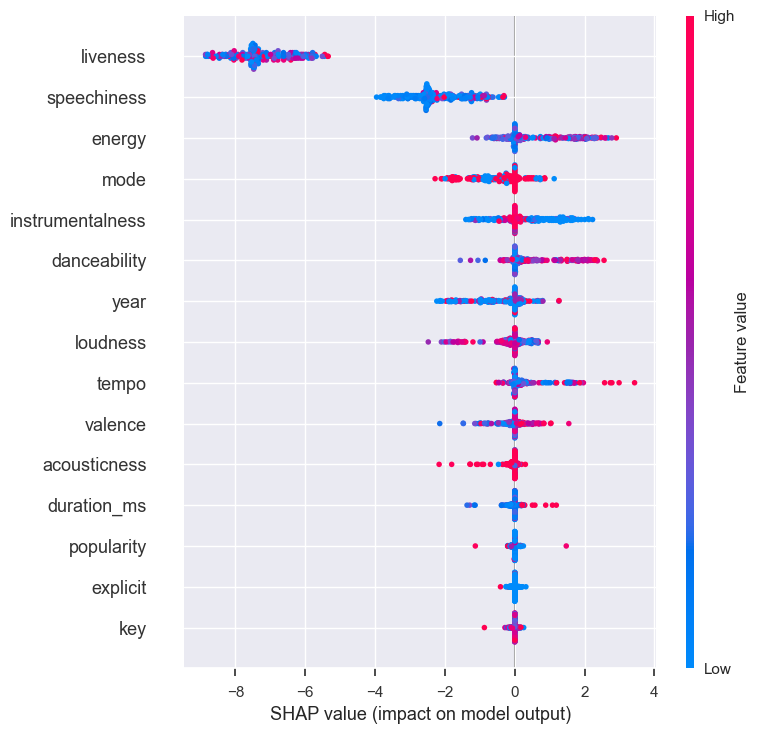

In [46]:
shap.summary_plot( explainer.shap_values(X[:250]), X[:250] )

In [47]:
shap.force_plot(explainer.expected_value, explainer.shap_values(X[49950:50000]), X[49950:50000])

  0%|          | 0/50 [00:00<?, ?it/s]

In [48]:
shap.force_plot(explainer.expected_value, explainer.shap_values(X[170000:170050]), X[170000:170050])

  0%|          | 0/50 [00:00<?, ?it/s]

In [49]:
def explainRecommendation(song: str, year:int)->None:
    table=recommend(song, year)

In [50]:
def songs(x):
    #x is a list of songs
    arr = []
    for i in x:
        arr.extend(recommend(i[0], i[1], i[2]))
    return arr

In [51]:
x = [['Happy Together', 1961, ''], ['Blinding Lights', 2020, 'The WEEKND']]

In [52]:
songs(x)

[{'name': 'Michelle - Remastered 2009',
  'year': 1965,
  'artists': "['The Beatles']"},
 {'name': "Groovin'", 'year': 1967, 'artists': "['The Young Rascals']"},
 {'name': 'God Only Knows - Remastered',
  'year': 1966,
  'artists': "['The Beach Boys']"},
 {'name': "Walkin' Back to Georgia", 'year': 1972, 'artists': "['Jim Croce']"},
 {'name': "Let's Stay Together", 'year': 1972, 'artists': "['Al Green']"},
 {'name': 'I Feel the Earth Move', 'year': 1971, 'artists': "['Carole King']"},
 {'name': 'Sway (Quien Sera)', 'year': 1954, 'artists': "['Dean Martin']"},
 {'name': 'Breakdown',
  'year': 1976,
  'artists': "['Tom Petty and the Heartbreakers']"},
 {'name': 'I Heard It Through The Grapevine',
  'year': 1968,
  'artists': "['Marvin Gaye']"},
 {'name': 'Secrets', 'year': 2009, 'artists': "['OneRepublic']"},
 {'name': "They Don't Know About Us",
  'year': 2012,
  'artists': "['One Direction']"},
 {'name': 'Thunder', 'year': 2017, 'artists': "['Imagine Dragons']"},
 {'name': 'Forever Aft

In [ ]:
def 